<a href="https://colab.research.google.com/github/Cesare-Caputo/PyPSA-gridtracer/blob/main/Duke_Training.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


# Install Detectron2



In [ ]:
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu111/torch1.9/index.html # cuda 11.1
# exit()  # restart runtim
# !pip install geopandas rtree fiftyone

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu111/torch1.9/index.html
     |████████████████████████████████| 6.9 MB 2.4 MB/s 
     |████████████████████████████████| 50 kB 6.0 MB/s 
     |████████████████████████████████| 79 kB 7.3 MB/s 
     |████████████████████████████████| 151 kB 70.6 MB/s 
     |████████████████████████████████| 130 kB 82.2 MB/s 
     |████████████████████████████████| 843 kB 82.4 MB/s 
     |████████████████████████████████| 596 kB 78.6 MB/s 
     |████████████████████████████████| 117 kB 74.4 MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.5.post20220512-py3-none-any.whl size=61288 sha256=8bd544acd512633d7864e3e6f682c3e68c9c3c80508d7ed322a39f626d4c6951
  Stored in directory: /root/.cache/pip/wheels/68/20/f9/a11a0dd63f4c13678b2a5ec488e48078756505c7777b75b29e
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.9

In [ ]:
from detectron2.config import get_cfg
print(get_cfg())

CUDNN_BENCHMARK: False
DATALOADER:
  ASPECT_RATIO_GROUPING: True
  FILTER_EMPTY_ANNOTATIONS: True
  NUM_WORKERS: 4
  REPEAT_THRESHOLD: 0.0
  SAMPLER_TRAIN: TrainingSampler
DATASETS:
  PRECOMPUTED_PROPOSAL_TOPK_TEST: 1000
  PRECOMPUTED_PROPOSAL_TOPK_TRAIN: 2000
  PROPOSAL_FILES_TEST: ()
  PROPOSAL_FILES_TRAIN: ()
  TEST: ()
  TRAIN: ()
GLOBAL:
  HACK: 1.0
INPUT:
  CROP:
    ENABLED: False
    SIZE: [0.9, 0.9]
    TYPE: relative_range
  FORMAT: BGR
  MASK_FORMAT: polygon
  MAX_SIZE_TEST: 1333
  MAX_SIZE_TRAIN: 1333
  MIN_SIZE_TEST: 800
  MIN_SIZE_TRAIN: (800,)
  MIN_SIZE_TRAIN_SAMPLING: choice
  RANDOM_FLIP: horizontal
MODEL:
  ANCHOR_GENERATOR:
    ANGLES: [[-90, 0, 90]]
    ASPECT_RATIOS: [[0.5, 1.0, 2.0]]
    NAME: DefaultAnchorGenerator
    OFFSET: 0.0
    SIZES: [[32, 64, 128, 256, 512]]
  BACKBONE:
    FREEZE_AT: 2
    NAME: build_resnet_backbone
  DEVICE: cuda
  FPN:
    FUSE_TYPE: sum
    IN_FEATURES: []
    NORM: 
    OUT_CHANNELS: 256
  KEYPOINT_ON: False
  LOAD_PROPOSALS: Fals

In [ ]:
# check pytorch installation:
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
assert torch.__version__.startswith("1.9")   # please manually install torch 1.9 if Colab changes its default version

1.9.0+cu102 True


# Set up Detect Energy

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# !git clone https://github.com/pypsa-meets-africa/detect_energy.git

In [ ]:
!pip install geopandas rtree fiftyone

     |████████████████████████████████| 1.0 MB 5.1 MB/s 
     |████████████████████████████████| 994 kB 52.9 MB/s 
     |████████████████████████████████| 1.2 MB 47.6 MB/s 
     |████████████████████████████████| 6.3 MB 48.2 MB/s 
     |████████████████████████████████| 15.4 MB 48.3 MB/s 
     |████████████████████████████████| 631 kB 59.1 MB/s 
     |████████████████████████████████| 79.9 MB 73 kB/s 
     |████████████████████████████████| 131 kB 52.4 MB/s 
     |████████████████████████████████| 29.2 MB 1.3 MB/s 
     |████████████████████████████████| 37.1 MB 96 kB/s 
     |████████████████████████████████| 13.2 MB 94 kB/s 
     |████████████████████████████████| 106 kB 56.2 MB/s 
     |████████████████████████████████| 55 kB 3.1 MB/s 
     |████████████████████████████████| 557 kB 59.0 MB/s 
     |████████████████████████████████| 225 kB 64.5 MB/s 
     |████████████████████████████████| 82 kB 754 kB/s 
     |████████████████████████████████| 58 kB 6.6 MB/s 
     |█████████████████

In [ ]:
import os
import importlib
import sys
# sys.path.append(os.getcwd()+'/detect_energy/image_download/')
import geopandas as gpd
import pandas as pd
import fiftyone as fo

/usr/local/lib/python3.7/dist-packages/distributed/config.py:20: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  defaults = yaml.load(f)


In [ ]:
# from main import make_all_examples
# from create_coco_format import to_coco
# from filter_tiles import filter_images, verify_df_img
# import main
# import create_coco_format
# import filter_tiles
# import make_examples

In [ ]:
# importlib.reload(create_coco_format)
# importlib.reload(main)
# importlib.reload(filter_tiles)

# Merge Duke Dataset

In [ ]:
# base_path = "/content/drive/MyDrive/PyPSA_Africa_images/"
# os.chdir(base_path)
# dirs = ['tauranga', 'palmertson', "china", "mexico", 'brazil']
# prefixes = ['TA', 'PA', "CH", "ME", "BR"]
# extract_duke_dataset(dirs, prefixes, imgs_per_tower=10, base_path=base_path)

In [ ]:
import fiftyone as fo
import numpy as np


def merge_datasets(dirs, ds_name, mode, launch=False):
    '''
    Takes datasets from individual countries as generated by the extract_duke
    method and merges all them into a training and a validation dataset.

    Parameters
    -----------
    dirs : (list of datasets)
        will be merged
    ds_name : (str)
        name of resulting dataset (will have mode as suffix)
    mode : (str)
        'train' gathers training examples, 'val' the validation ones
    launch : (boolean)
        determines if fiftyone app is launched to show resulting dataset
    '''

    try:
        merged_ds = fo.Dataset(ds_name)
    except:
        merged_ds = fo.load_dataset(ds_name)
        merged_ds.delete()
        merged_ds = fo.Dataset(name=ds_name)

    merged_ds.persistent = False

    for country in dirs:

        print('Getting examples from {}.'.format(country))

        name = country
        dataset_dir = f'/content/drive/My Drive/PyPSA_Africa_images/{country}/{mode}/'

        # A name for the dataset
        dataset_type = fo.types.COCODetectionDataset

        # The type of the dataset being imported
        dataset = fo.Dataset.from_dir(
          dataset_dir=dataset_dir,
          dataset_type=fo.types.COCODetectionDataset,
          name=str(np.random.randint(1, 1000000)),
        )
        merged_ds.merge_samples(dataset)


    out_path = f"/content/drive/MyDrive/PyPSA_Africa_images/datasets/{ds_name}/"

    label_field = "ground_truth"
    merged_ds.export(
          export_dir=out_path,
          dataset_type=fo.types.COCODetectionDataset,
          label_field=label_field,
          export_media=True
          )
    if launch: session = fo.launch_app(merged_ds)



if __name__ == '__main__':

    # create duke training dataset
    dirs = [
            'china',
             # 'hartford',    (APPEARS TO HAVE CORRUPTED GEOJSON FILES)
            'kansas',
            'dunedin',
            'gisborne',
            'palmertson',
            'rotorua',
            'tauranga',
            'wilmington',
            'arizona',
            #'brazil',
            'clyde',
            'sudan',
            'mexico'
            ]

    ds_name = 'duke_val'
    mode = 'val'
    merge_datasets(dirs, ds_name, mode, launch=False)



Getting examples from china.
 100% |█████████████████| 272/272 [735.1ms elapsed, 0s remaining, 373.0 samples/s]      
Getting examples from kansas.
 100% |█████████████████| 377/377 [898.7ms elapsed, 0s remaining, 426.9 samples/s]      
Getting examples from dunedin.
 100% |███████████████████| 25/25 [68.2ms elapsed, 0s remaining, 366.8 samples/s]     
Getting examples from gisborne.
 100% |█████████████████| 190/190 [429.3ms elapsed, 0s remaining, 452.0 samples/s]      
Getting examples from palmertson.
 100% |█████████████████| 197/197 [458.0ms elapsed, 0s remaining, 438.8 samples/s]      
Getting examples from rotorua.
 100% |███████████████████| 61/61 [156.1ms elapsed, 0s remaining, 416.1 samples/s]    
Getting examples from tauranga.
 100% |█████████████████| 135/135 [324.1ms elapsed, 0s remaining, 416.5 samples/s]      
Getting examples from wilmington.
 100% |███████████████████| 91/91 [214.9ms elapsed, 0s remaining, 423.5 samples/s]     
Getting examples from arizona.
 100% |██

In [ ]:
base_path = "/content/drive/MyDrive/PyPSA_Africa_images/datasets/overfit_val/"
label_field = "ground_truth"
merged_ds.export(
      export_dir=base_path,
      dataset_type=fo.types.COCODetectionDataset,
      label_field=label_field,
      export_media=False
      )

Directory '/content/drive/MyDrive/PyPSA_Africa_images/datasets/overfit_val/' already exists; export will be merged with existing files
 100% |█████████████████| 135/135 [253.0ms elapsed, 0s remaining, 533.5 samples/s]      


# Check for datasets

In [ ]:
import fiftyone as fo

name = 'duke_val'

data_path = '/content/drive/My Drive/PyPSA_Africa_images/datasets/'+name+'/data/'
labels_path = '/content/drive/My Drive/PyPSA_Africa_images/datasets/'+name+'/labels.json'

# Import the dataset
dataset_here = fo.Dataset.from_dir(
        dataset_type=fo.types.COCODetectionDataset,
        data_path=data_path,
        labels_path=labels_path,
        )

session = fo.launch_app(dataset_here)

 100% |███████████████| 4502/4502 [11.6s elapsed, 0s remaining, 426.4 samples/s]      


ValueError: ignored

# Training on Satellite Imagery

#### Register COCO Datasets

In [ ]:
!pip install pyyaml==5.1
# !pip uninstall torch
# !pip uninstall detectron2
!pip install torch==1.9.0+cu102 torchvision==0.10.0+cu102 -f https://download.pytorch.org/whl/torch_stable.html
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu102/torch1.9/index.html

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 274 kB 8.2 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44092 sha256=0c1a782e2104e081ae9c4a6aa6aadda21c31e7fbe38132894bd8b52760c2556b
  Stored in directory: /root/.cache/pip/wheels/77/f5/10/d00a2bd30928b972790053b5de0c703ca87324f3fead0f2fd9
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |████████████████████████████████| 831.4 MB 2.9 kB/s 
     |████████████████████████████████| 22.1 MB 53 kB/s 
  Attempting uninstall: torch
    Found existing installation: torch 1.11.0+cu113
    Uninstalling torch-1.11.0+cu113:
   

In [ ]:
from detectron2.config import get_cfg

print(get_cfg())

CUDNN_BENCHMARK: False
DATALOADER:
  ASPECT_RATIO_GROUPING: True
  FILTER_EMPTY_ANNOTATIONS: True
  NUM_WORKERS: 4
  REPEAT_THRESHOLD: 0.0
  SAMPLER_TRAIN: TrainingSampler
DATASETS:
  PRECOMPUTED_PROPOSAL_TOPK_TEST: 1000
  PRECOMPUTED_PROPOSAL_TOPK_TRAIN: 2000
  PROPOSAL_FILES_TEST: ()
  PROPOSAL_FILES_TRAIN: ()
  TEST: ()
  TRAIN: ()
GLOBAL:
  HACK: 1.0
INPUT:
  CROP:
    ENABLED: False
    SIZE: [0.9, 0.9]
    TYPE: relative_range
  FORMAT: BGR
  MASK_FORMAT: polygon
  MAX_SIZE_TEST: 1333
  MAX_SIZE_TRAIN: 1333
  MIN_SIZE_TEST: 800
  MIN_SIZE_TRAIN: (800,)
  MIN_SIZE_TRAIN_SAMPLING: choice
  RANDOM_FLIP: horizontal
MODEL:
  ANCHOR_GENERATOR:
    ANGLES: [[-90, 0, 90]]
    ASPECT_RATIOS: [[0.5, 1.0, 2.0]]
    NAME: DefaultAnchorGenerator
    OFFSET: 0.0
    SIZES: [[32, 64, 128, 256, 512]]
  BACKBONE:
    FREEZE_AT: 2
    NAME: build_resnet_backbone
  DEVICE: cuda
  FPN:
    FUSE_TYPE: sum
    IN_FEATURES: []
    NORM: 
    OUT_CHANNELS: 256
  KEYPOINT_ON: False
  LOAD_PROPOSALS: Fals

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# Common Libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# Detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.data.datasets import register_coco_instances

In [ ]:
os.getcwd()

'/content'

In [ ]:
%cd "/content/drive/MyDrive/PyPSA_Africa_images/datasets"

/content/drive/MyDrive/PyPSA_Africa_images/datasets


In [ ]:
from itertools import product


for d, ds in product(["train", "val"], ['duke']):
    ds_path = f'/content/drive/My Drive/PyPSA_Africa_images/datasets/{ds}_{d}/data/'
    json_path = f'/content/drive/My Drive/PyPSA_Africa_images/datasets/{ds}_{d}/labels.json'
    ds_name = f'{ds}_{d}'

    if ds_name in DatasetCatalog.list():
        DatasetCatalog.remove(ds_name)
        MetadataCatalog.remove(ds_name)

    register_coco_instances(ds_name, {}, json_path, ds_path)


ds_name = 'iscrowd_manual_maxar_val'
ds_path = f'/content/drive/My Drive/PyPSA_Africa_images/datasets/{ds_name}/data/'
json_path = f'/content/drive/My Drive/PyPSA_Africa_images/datasets/{ds_name}/labels.json'

if ds_name in DatasetCatalog.list():
    DatasetCatalog.remove(ds_name)
    MetadataCatalog.remove(ds_name)

register_coco_instances(ds_name, {}, json_path, ds_path)

In [ ]:
train_dataset = 'duke_train'
val_dataset = 'duke_val'
train_metadata = MetadataCatalog.get(train_dataset)
val_metadata = MetadataCatalog.get(val_dataset)

#### Visualize the annotations of randomly selected samples in the training set:

WARNING [02/25 15:44:06 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[02/25 15:44:06 d2.data.datasets.coco]: Loaded 855 images in COCO format from /content/drive/My Drive/PyPSA_Africa_images/datasets/manual_maxar_val/labels.json
[{'file_name': '/content/drive/My Drive/PyPSA_Africa_images/datasets/manual_maxar_val/data/GH_25355053540.png', 'height': 256, 'width': 256, 'image_id': 1, 'annotations': [{'bbox': [68.0, 46.0, 30.0, 36.0], 'category_id': 0, 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'bbox': [82.0, 121.0, 31.0, 34.0], 'category_id': 0, 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'bbox': [59.0, 184.0, 24.0, 27.0], 'category_id': 0, 'bbox_mode': <BoxMode.XYWH_ABS: 1>}]}, {'file_name': '/content/drive/My Drive/PyPSA_Africa_images/datasets/manual_maxar_val/data/GH_25355053630.png', 'height': 256, 'width': 256, 'image_id': 2, 'annotations': [{'bbox': [219.0, 127.0, 30.0, 33.0], 'category_id': 0, 'bbox_mode': <BoxMode.XYWH_ABS

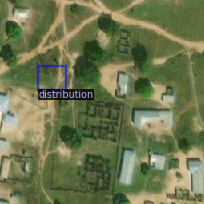

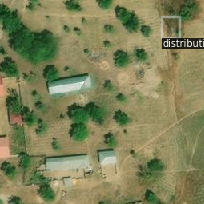

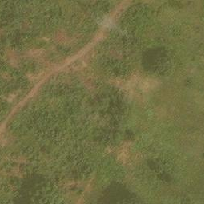

In [ ]:
dataset = 'manual_maxar_val'
dataset_dicts = DatasetCatalog.get(dataset)
tower_metadata = MetadataCatalog.get(dataset)

print(dataset_dicts)

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=tower_metadata, scale=0.8, instance_mode=1)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

## Train Model


In [ ]:
!nvidia-smi

Fri Feb 25 15:29:39 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   37C    P8     9W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator
from detectron2.evaluation import inference_on_dataset
from detectron2.data import build_detection_test_loader
from detectron2.data import DatasetMapper


class EvalTrainer(DefaultTrainer):
    def __init__(self, cfg):
        super().__init__(cfg)

        self.same_data_loader = build_detection_test_loader(DatasetCatalog.get(cfg.DATASETS.TEST1),
                                                            mapper=DatasetMapper(cfg, is_train=False))
        self.same_data_eval = COCOEvaluator(cfg.DATASETS.TEST1)
        self.manual_maxar_loader = build_detection_test_loader(DatasetCatalog.get(cfg.DATASETS.TEST2),
                                                            mapper=DatasetMapper(cfg, is_train=False))
        self.manual_maxar_eval = COCOEvaluator(cfg.DATASETS.TEST2)


    def after_step(self):
        super().after_step()

        if self.iter % self.cfg.TEST.INTERVAL == 0:

            # same_data_results = inference_on_dataset(self.model,
            #                                          self.same_data_loader,
            #                                          self.same_data_eval)

            global results

            results = inference_on_dataset(self.model,
                                                     self.manual_maxar_loader,
                                                     self.manual_maxar_eval)

            print(results)
            print(type(results))

            a = e


In [ ]:
# For a custom training loop a custom training loop can be written as shown in plain_train_net.py https://github.com/facebookresearch/detectron2/tree/master/tools
from detectron2.engine import DefaultTrainer # https://detectron2.readthedocs.io/modules/engine.html?highlight=defaulttrainer#detectron2.engine.defaults.DefaultTrainer
from datetime import date

cfg = get_cfg() # Model Confi


frcnn= 'faster_rcnn_R_101_FPN_3x.yaml'

# From Detectron2 Model Zoo
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/"+frcnn))    # https://github.com/facebookresearch/detectron2/blob/main/configs/COCO-Detection/retinanet_R_101_FPN_3x.yaml
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/"+frcnn)  # Pre-trained Model Weights

cfg.DATALOADER.NUM_WORKERS = 2  # Number of CPUs to load the data into Detectron2 - 2 for Colab
cfg.SOLVER.IMS_PER_BATCH = 2    # Detectron2 default 16 with 8 GPUs, so 16/8 = 2 for 1 GPU

cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2   # for R-CNN Models

cfg.defrost()

cfg.DATASETS.TRAIN = ('duke_train')
cfg.DATASETS.TEST1 = ('duke_val')
cfg.DATASETS.TEST2 = ('iscrowd_manual_maxar_val')
cfg.TEST.INTERVAL = 30
model_name = str(date.today()) + '_dummy'
cfg.OUTPUT_DIR = '/content/drive/MyDrive/PyPSA_Africa_images/models/' + model_name

cfg.freeze()

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = EvalTrainer(cfg)
trainer.resume_or_load(resume=False)




[02/25 15:44:27 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (3, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (3,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (8, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (8,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, we

In [ ]:
trainer.train()

print('The total number of iterations is now at 180000!')

[02/25 15:44:32 d2.engine.train_loop]: Starting training from iteration 0
[02/25 15:44:33 d2.evaluation.evaluator]: Start inference on 855 batches
[02/25 15:44:53 d2.evaluation.evaluator]: Inference done 11/855. Dataloading: 0.2991 s/iter. Inference: 0.1081 s/iter. Eval: 0.0003 s/iter. Total: 0.4074 s/iter. ETA=0:05:43
[02/25 15:44:58 d2.evaluation.evaluator]: Inference done 22/855. Dataloading: 0.3308 s/iter. Inference: 0.1083 s/iter. Eval: 0.0003 s/iter. Total: 0.4396 s/iter. ETA=0:06:06
[02/25 15:45:03 d2.evaluation.evaluator]: Inference done 33/855. Dataloading: 0.3414 s/iter. Inference: 0.1083 s/iter. Eval: 0.0003 s/iter. Total: 0.4501 s/iter. ETA=0:06:10
[02/25 15:45:08 d2.evaluation.evaluator]: Inference done 44/855. Dataloading: 0.3496 s/iter. Inference: 0.1085 s/iter. Eval: 0.0003 s/iter. Total: 0.4585 s/iter. ETA=0:06:11
[02/25 15:45:13 d2.evaluation.evaluator]: Inference done 55/855. Dataloading: 0.3518 s/iter. Inference: 0.1085 s/iter. Eval: 0.0003 s/iter. Total: 0.4608 s/i

NameError: ignored

In [ ]:
results

with open('result.json', 'w') as out:
    json.dump(results, out)

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

## Inference & evaluation using the trained model
Create a predictor



In [ ]:
model_name = '2021-10-18_retina101_100000_dukeset'
cfg.OUTPUT_DIR = '/content/drive/MyDrive/PyPSA_Africa_images/models/' + model_name

In [ ]:
# Inference should use the config with parameters that are used in training
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.5 # For RetinaNet
# cfg.MODEL.RETINANET.NMS_THRESH_TEST = 0.5 # For RetinaNet (optional)
# cfg.TEST.DETECTIONS_PER_IMAGE = 1 # Not sure, but makes sense
predictor = DefaultPredictor(cfg)

Visualize the prediction results


WARNING [10/21 14:52:13 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[10/21 14:52:13 d2.data.datasets.coco]: Loaded 11813 images in COCO format from /content/drive/My Drive/PyPSA_Africa_images/datasets/duke_train/labels.json


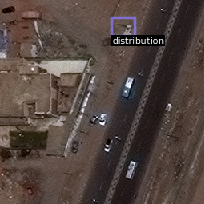

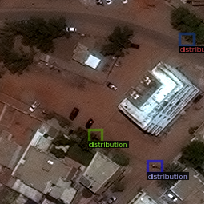

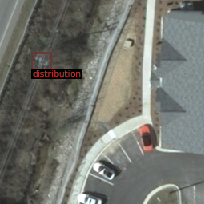

In [ ]:
viz_dataset = train_dataset
dataset_dicts = DatasetCatalog.get(viz_dataset)
tower_metadata = MetadataCatalog.get(viz_dataset)
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=tower_metadata, scale=0.8)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

WARNING [10/21 14:52:48 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[10/21 14:52:48 d2.data.datasets.coco]: Loaded 4502 images in COCO format from /content/drive/My Drive/PyPSA_Africa_images/datasets/duke_val/labels.json


/usr/local/lib/python3.7/dist-packages/torch/_tensor.py:575: UserWarning: floor_divide is deprecated, and will be removed in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values.
To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor'). (Triggered internally at  /pytorch/aten/src/ATen/native/BinaryOps.cpp:467.)
  return torch.floor_divide(self, other)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


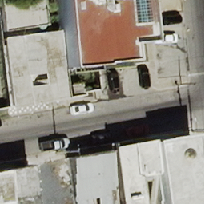

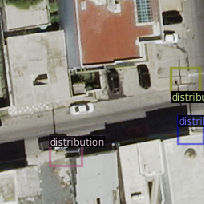

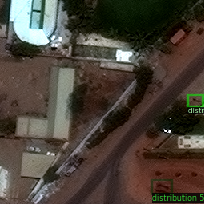

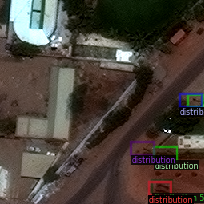

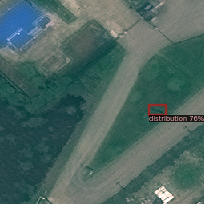

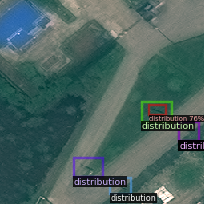

In [ ]:
from detectron2.utils.visualizer import ColorMode
# num_to_draw = 1 # assuming 1 tower per tile
val_dataset_dicts = DatasetCatalog.get(val_dataset)
for d in random.sample(val_dataset_dicts, 3):
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    # print(outputs)
    v = Visualizer(im[:, :, ::-1],
                   metadata=tower_metadata,
                   scale=0.8
    )
    # print(outputs["instances"].to("cpu"))
    # out = v.draw_instance_predictions(outputs["instances"][:num_to_draw].to("cpu")) # Draw num_to_draw boxes
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])
    out2 = v.draw_dataset_dict(d)
    cv2_imshow(out2.get_image()[:, :, ::-1])

Add 'iscrowd' to val dataset (quick fix)

In [ ]:
import json

suffix = '_fixed'
d = 'val'
ds_path = os.path.join(os.getcwd(), f'duke_{d}', '')
val_dict = json.load(open(ds_path+'labels.json'))
# print(json.dumps(val_dict, indent=4, sort_keys=True))
for annotation in val_dict['annotations']:
  annotation['iscrowd'] = 0
with open(ds_path + 'labels_fixed.json', 'w') as fp:
  json.dump(val_dict, fp)

In [ ]:
suffix = '_fixed'
d = 'val'
ds_path = os.path.join(os.getcwd(), f'duke_{d}', '')
register_coco_instances("tower_" + d + suffix, {}, ds_path + "labels_fixed.json", ds_path)

In [ ]:
tower_val_dataset = 'tower_val' + suffix

Evaluation using AP metric implemented in COCO API.

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset, DatasetEvaluator
from detectron2.data import build_detection_test_loader

# Using COCO Evaluator https://detectron2.readthedocs.io/modules/evaluation.html#detectron2.evaluation.COCOEvaluator
evaluator = COCOEvaluator(val_dataset)
# evaluator = DatasetEvaluator()
# evaluator = COCOEvaluator(tower_val_dataset, cfg, False, output_dir="./output/")

# Data loader
val_loader = build_detection_test_loader(cfg, val_dataset)

# Inference
inference_on_dataset(model=trainer.model,
                     data_loader=val_loader,
                     evaluator=evaluator)

# another equivalent way to evaluate the model is to use `trainer.test`
# trainer.test(cfg=cfg,
#              model=trainer.model,
#              evaluator=evaluator)

WARNING [10/21 14:53:33 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[10/21 14:53:33 d2.data.datasets.coco]: Loaded 4502 images in COCO format from /content/drive/My Drive/PyPSA_Africa_images/datasets/duke_val/labels.json
[10/21 14:53:33 d2.data.build]: Distribution of instances among all 2 categories:
|   category   | #instances   |   category   | #instances   |
|:------------:|:-------------|:------------:|:-------------|
| distribution | 11753        | transmission | 581          |
|              |              |              |              |
|    total     | 12334        |              |              |
[10/21 14:53:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[10/21 14:53:33 d2.data.common]: Serializing 4502 elements to byte tensors and concatenating them all ...
[10/21 14:53:33 d2.data.common]:

KeyboardInterrupt: ignored

## Inference on Maxar

In [ ]:
!pwd

/content/drive/.shortcut-targets-by-id/1pMhI9rIgnuKcDAsGFtXv8j0Vxg2vNqyE/PyPSA_Africa_images/datasets


In [ ]:
%cd ..

/content/drive/.shortcut-targets-by-id/1pMhI9rIgnuKcDAsGFtXv8j0Vxg2vNqyE/PyPSA_Africa_images


In [ ]:
%cd maxar_test/

/content/drive/.shortcut-targets-by-id/1pMhI9rIgnuKcDAsGFtXv8j0Vxg2vNqyE/PyPSA_Africa_images/maxar_test


In [ ]:
suffix = 'newer'
d = 'val'
prov = 'maxar'
# ds_path = os.path.join(os.getcwd(), f'{prov}_{d}', '')
ds_path = os.path.join(os.getcwd(),'')
register_coco_instances(f"tower_{d}_{prov}_{suffix}", {}, ds_path + f"tower_coco_{d}.json", ds_path)

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset, DatasetEvaluator
from detectron2.data import build_detection_test_loader

inf_dataset = 'tower_val_maxar_newer'

# Using COCO Evaluator https://detectron2.readthedocs.io/modules/evaluation.html#detectron2.evaluation.COCOEvaluator
evaluator = COCOEvaluator(inf_dataset)
# evaluator = DatasetEvaluator()
# evaluator = COCOEvaluator(tower_val_dataset, cfg, False, output_dir="./output/")

# Data loader
val_loader = build_detection_test_loader(cfg, inf_dataset)

# Inference
inference_on_dataset(model=trainer.model,
                     data_loader=val_loader,
                     evaluator=evaluator)

# another equivalent way to evaluate the model is to use `trainer.test`
# trainer.test(cfg=cfg,
#              model=trainer.model,
#              evaluator=evaluator)

[10/21 15:19:38 d2.data.datasets.coco]: Loaded 112 images in COCO format from /content/drive/.shortcut-targets-by-id/1pMhI9rIgnuKcDAsGFtXv8j0Vxg2vNqyE/PyPSA_Africa_images/maxar_test/tower_coco_val.json
[10/21 15:19:38 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|   tower    | 112          |
|            |              |
[10/21 15:19:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[10/21 15:19:38 d2.data.common]: Serializing 112 elements to byte tensors and concatenating them all ...
[10/21 15:19:38 d2.data.common]: Serialized dataset takes 0.04 MiB
[10/21 15:19:38 d2.evaluation.evaluator]: Start inference on 112 batches
[10/21 15:19:42 d2.evaluation.evaluator]: Inference done 11/112. Dataloading: 0.0016 s/iter. Inference: 0.3896 s/iter. Eval: 0.0002 s/iter. Total: 0.3914 s/iter. ETA=0:00:3

AssertionError: ignored

[10/21 15:24:53 d2.data.datasets.coco]: Loaded 112 images in COCO format from /content/drive/.shortcut-targets-by-id/1pMhI9rIgnuKcDAsGFtXv8j0Vxg2vNqyE/PyPSA_Africa_images/maxar_test/tower_coco_val.json


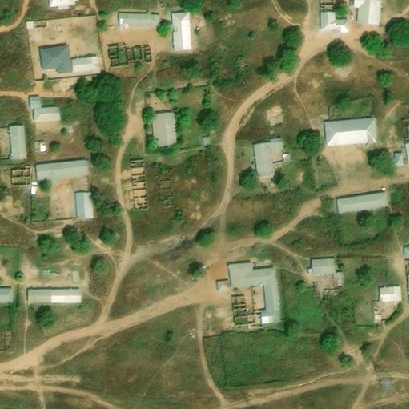

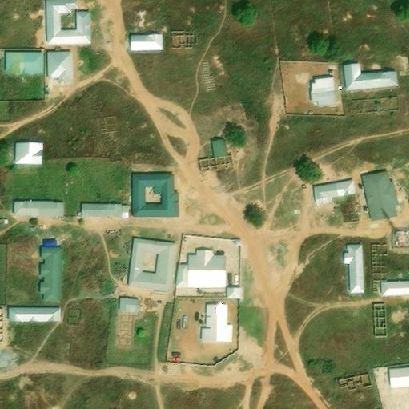

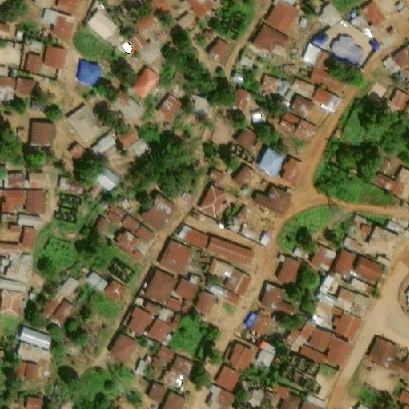

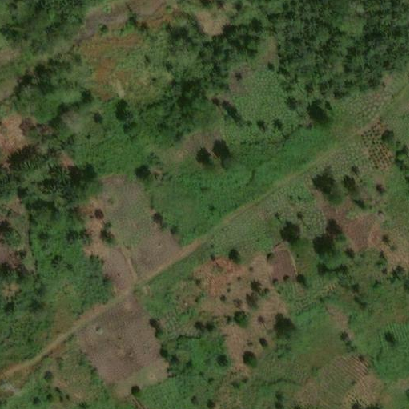

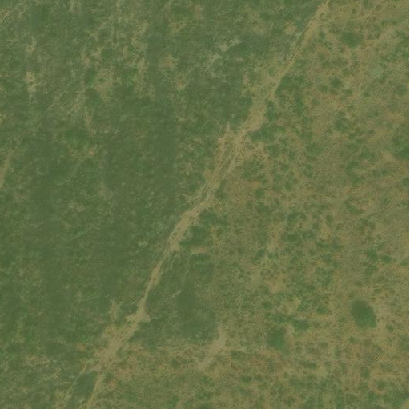

...

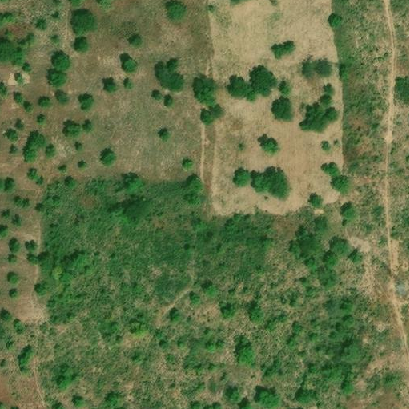

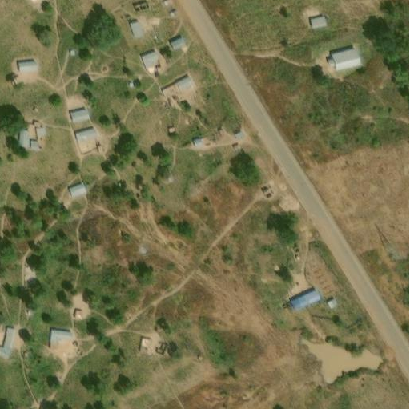

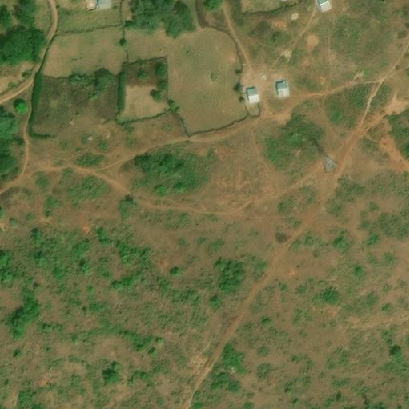

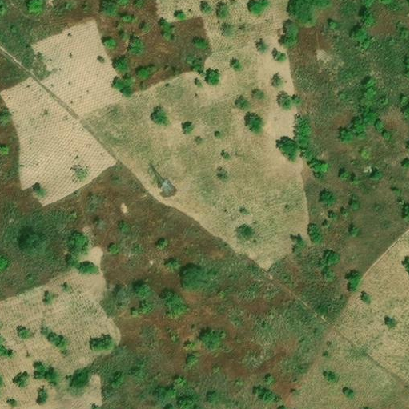

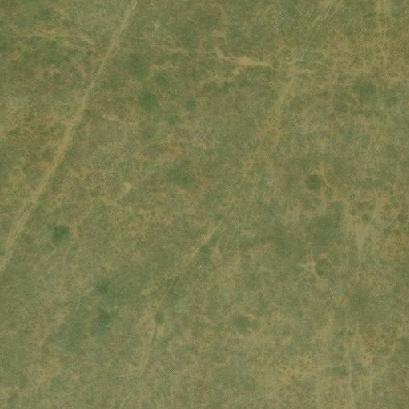

IndexError: ignored

In [ ]:
from detectron2.utils.visualizer import ColorMode
# num_to_draw = 1 # assuming 1 tower per tile
val_dataset_dicts = DatasetCatalog.get(inf_dataset)
tower_metadata =MetadataCatalog.get(inf_dataset)
for d in random.sample(val_dataset_dicts, 100):
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    # print(outputs)
    v = Visualizer(im[:, :, ::-1],
                   metadata=tower_metadata,
                   scale=0.8
    )
    # print(outputs["instances"].to("cpu"))
    # out = v.draw_instance_predictions(outputs["instances"][:num_to_draw].to("cpu")) # Draw num_to_draw boxes
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])
    # out2 = v.draw_dataset_dict(d)
    # cv2_imshow(out2.get_image()[:, :, ::-1])

### Cluster runs script

In [ ]:
# torch
import torch
import torchvision

# Detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# Common Libraries
import numpy as np
import os, json, cv2, random
import matplotlib.pyplot as plt
from itertools import product
from datetime import date
# from google.colab.patches import cv2_imshow

# Detectron2 utilities
from detectron2 import model_zoo
from detectron2.config import get_cfg
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.data.datasets import register_coco_instances
from detectron2.engine import DefaultTrainer
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator
from detectron2.evaluation import inference_on_dataset
from detectron2.data import build_detection_test_loader
from detectron2.data import DatasetMapper


# os.chdir(os.path.join(os.getcwd(), '..', 'datasets'))
os.chdir('/content/drive/MyDrive/PyPSA_Africa_images/datasets')

# os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
# os.environ["CUDA_VISIBLE_DEVICES"]="0"

for d, ds in product(["train", "val"], ['fake_maxar', 'duke']):
    ds_path = os.path.join(os.getcwd(), f'{ds}_{d}', 'data')
    json_path = os.path.join(os.getcwd(), f'{ds}_{d}', 'labels.json')
    ds_name = f'{ds}_{d}'

    if ds_name in DatasetCatalog.list():
        DatasetCatalog.remove(ds_name)
        MetadataCatalog.remove(ds_name)

    register_coco_instances(ds_name, {}, json_path, ds_path)


ds_name = 'manual_maxar_val'
ds_path = os.path.join(os.getcwd(), f'{ds_name}', 'data')
json_path = os.path.join(os.getcwd(), f'{ds_name}', 'labels.json')

if ds_name in DatasetCatalog.list():
    DatasetCatalog.remove(ds_name)
    MetadataCatalog.remove(ds_name)

register_coco_instances(ds_name, {}, json_path, ds_path)

print('Registered datasets!')

class EvalTrainer(DefaultTrainer):
    def __init__(self, cfg):
        super().__init__(cfg)

        self.same_data_loader = build_detection_test_loader(DatasetCatalog.get(cfg.DATASETS.TEST1),
                                                            mapper=DatasetMapper(cfg, is_train=False))
        self.same_data_eval = COCOEvaluator(cfg.DATASETS.TEST1)
        self.manual_maxar_loader = build_detection_test_loader(DatasetCatalog.get(cfg.DATASETS.TEST2),
                                                            mapper=DatasetMapper(cfg, is_train=False))
        self.manual_maxar_eval = COCOEvaluator(cfg.DATASETS.TEST2)


    def after_step(self):
        super().after_step()

        if (self.iter + 1) % self.cfg.TEST.INTERVAL == 0:

            results = inference_on_dataset(self.model,
                                                     self.manual_maxar_loader,
                                                     self.manual_maxar_eval)

            with open(
                os.path.join(
                    self.cfg.OUTPUT_DIR,
                    'eval_manualsdata_'+str(self.cfg.DATASETS.TRAIN)+'_iter_'+str(self.iter)+'.json'),
                    'w') as out:
                json.dump(results, out)

            same_data_results = inference_on_dataset(self.model,
                                                     self.same_data_loader,
                                                     self.same_data_eval)


            with open(
                os.path.join(
                    self.cfg.OUTPUT_DIR,
                    'eval_samedata_'+str(self.cfg.DATASETS.TRAIN)+'_iter_'+str(self.iter)+'.json'),
                    'w') as out:
                json.dump(same_data_results, out)

print('Defined trainer class!')


def do_train(train_dataset='duke'):

    cfg = get_cfg()

    frcnn= 'faster_rcnn_R_101_FPN_3x.yaml'

    # From Detectron2 Model Zoo
    cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/"+frcnn))
    cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/"+frcnn)

    cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2   # for R-CNN Models

    cfg.defrost()
    cfg.DATASETS.TRAIN = (train_dataset+'_train')
    cfg.DATASETS.TEST1 = (train_dataset+'_val')
    cfg.DATASETS.TEST2 = ('manual_maxar_val')
    cfg.TEST.INTERVAL = 30_000
    cfg.SOLVER.IMS_PER_BATCH = 1
    # cfg.SOLVER.MAX_ITER = 800_000
    # cfg.SOLVER.STEPS = (300_000, 600_000)

    model_name = "testrun_" + str(date.today()) + '_' + train_dataset
    cfg.OUTPUT_DIR = '../models/' + model_name

    cfg.freeze()

    os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
    trainer = EvalTrainer(cfg)
    trainer.resume_or_load(resume=True)

    trainer.train()


for ds in ['duke', 'fake_maxar']:
    print('Commencing training on '+ds+'!')
    do_train(ds)

Registered datasets!
Defined trainer class!
Commencing training on duke!
[03/01 00:14:44 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): F

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (3, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (3,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (8, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (8,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, we

[03/01 00:14:48 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/torch/_tensor.py:575: UserWarning: floor_divide is deprecated, and will be removed in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values.
To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor'). (Triggered internally at  /pytorch/aten/src/ATen/native/BinaryOps.cpp:467.)
  return torch.floor_divide(self, other)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


Streaming output truncated to the last 5000 lines.
[03/01 05:27:40 d2.utils.events]:  eta: 8:42:39  iter: 90499  total_loss: 0.2595  loss_cls: 0.1029  loss_box_reg: 0.103  loss_rpn_cls: 0.01121  loss_rpn_loc: 0.00853  time: 0.1743  data_time: 0.0021  lr: 0.02  max_mem: 1652M
[03/01 05:27:43 d2.utils.events]:  eta: 8:42:13  iter: 90519  total_loss: 0.3346  loss_cls: 0.1332  loss_box_reg: 0.1433  loss_rpn_cls: 0.01849  loss_rpn_loc: 0.01381  time: 0.1743  data_time: 0.0022  lr: 0.02  max_mem: 1652M
[03/01 05:27:47 d2.utils.events]:  eta: 8:42:32  iter: 90539  total_loss: 0.2112  loss_cls: 0.1009  loss_box_reg: 0.1093  loss_rpn_cls: 0.01446  loss_rpn_loc: 0.007632  time: 0.1743  data_time: 0.0022  lr: 0.02  max_mem: 1652M
[03/01 05:27:50 d2.utils.events]:  eta: 8:42:16  iter: 90559  total_loss: 0.3579  loss_cls: 0.131  loss_box_reg: 0.1313  loss_rpn_cls: 0.01944  loss_rpn_loc: 0.01179  time: 0.1743  data_time: 0.0021  lr: 0.02  max_mem: 1652M
[03/01 05:27:54 d2.utils.events]:  eta: 8:42:1

KeyboardInterrupt: ignored

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/
